# Setting up the kaggle dataset to load (need to upload api key/json file)

In [3]:
!pip install --upgrade --force-reinstall --no-deps kaggle

     |████████████████████████████████| 61kB 6.4MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.12-cp37-none-any.whl size=73053 sha256=e82d66a680710a2e1b7ff303bd11e59b6000aa72330269ef53fc135aa4b6f306
  Stored in directory: /root/.cache/pip/wheels/a1/6a/26/d30b7499ff85a4a4593377a87ecf55f7d08af42f0de9b60303
Successfully built kaggle
  Found existing installation: kaggle 1.5.12
    Uninstalling kaggle-1.5.12:
      Successfully uninstalled kaggle-1.5.12


In [4]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"varung2","key":"7788900bc617e49c385400d8dfbcac07"}'}

In [5]:
 !mkdir ~/.kaggle
 !cp kaggle.json ~/.kaggle/
 !chmod 600 ~/.kaggle/kaggle.json

In [6]:
!kaggle datasets list

ref                                                         title                                              size  lastUpdated          downloadCount  voteCount  usabilityRating  
----------------------------------------------------------  ------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
gpreda/reddit-vaccine-myths                                 Reddit Vaccine Myths                              222KB  2021-04-03 08:45:43           1686        181  1.0              
crowww/a-large-scale-fish-dataset                           A Large Scale Fish Dataset                          3GB  2021-02-17 16:10:44           1111        121  1.0              
dhruvildave/wikibooks-dataset                               Wikibooks Dataset                                   1GB  2021-02-18 10:08:27            880         93  1.0              
imsparsh/musicnet-dataset                                   MusicNet Dataset              

# Loading libraries

In [49]:
import torch
from torch import nn
from torchsummary import summary
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
import torchvision

%load_ext tensorboard
torch.manual_seed(1)

# other packages
import numpy as np
import glob, os, shutil
from pathlib import Path
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm as tqdm
%matplotlib inline

# for loading the tpu
enable_tpu = False
try:
    import torch_xla
    import torch_xla.core.xla_model as xm
    enable_tpu = True
except ImportError:
    pass

# set the device to use
device = None
if (enable_tpu):                
    device = xm.xla_device()
elif torch.cuda.is_available(): 
    device = torch.device("cuda:"+str(torch.cuda.current_device()))
    print("CUDA device name: {}".format(torch.cuda.get_device_name(torch.cuda.current_device())))
else:                           
    device = torch.device("cpu")

print("Using device: {}".format(device))

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
CUDA device name: Tesla T4
Using device: cuda:0


#Data Loading

In [ ]:
!kaggle datasets download -d tawsifurrahman/covid19-radiography-database
!mkdir covid19_radiography_data
!unzip covid19-radiography-database.zip -d covid19_radiography_data

In [9]:
!mkdir -p /content/covid19_radiography_data/{test/{covid,normal},train/{covid,normal}}
!find /content/covid19_radiography_data/COVID-19_Radiography_Dataset/COVID/ -maxdepth 1 -type f | head -1000 | xargs cp -t /content/covid19_radiography_data/train/covid/
!find /content/covid19_radiography_data/COVID-19_Radiography_Dataset/Normal/ -maxdepth 1 -type f | head -1000 | xargs cp -t /content/covid19_radiography_data/train/normal/
!find /content/covid19_radiography_data/COVID-19_Radiography_Dataset/COVID/ -maxdepth 1 -type f | tail -1000 | xargs cp -t /content/covid19_radiography_data/test/covid/
!find /content/covid19_radiography_data/COVID-19_Radiography_Dataset/Normal/ -maxdepth 1 -type f | tail -1000 | xargs cp -t /content/covid19_radiography_data/test/normal/

In [23]:
# implementing a custom transformer class to normalize images between -1 and 1
class xray_normalizer(object):
    def __call__(self, img):
        retimg = np.asarray(img)
        retimg = (retimg - np.min(retimg)) / np.max(retimg - np.min(retimg))
        return (retimg*2.0 - 1.0)
    def __repr__(self):
        return self.__class__.__name__+'()'
class cast_tensor(object):
    def __init__(self, dtype):
        self.dtype = dtype
    def __call__(self, img_tensor):
        return img_tensor.type(self.dtype)

In [24]:
root = '/content/covid19_radiography_data/'
data_transform = torchvision.transforms.Compose([
    torchvision.transforms.Grayscale(),
    torchvision.transforms.Resize((300, 300)),
    xray_normalizer(),
    torchvision.transforms.ToTensor(),
    cast_tensor(torch.FloatTensor)
])
image_dataset = torchvision.datasets.ImageFolder(root=os.path.join(root, 'train'), transform=data_transform)
loader = DataLoader(image_dataset, shuffle=True, batch_size=4)

Batch[0].class: Covid
Batch[0].shape: (300, 300)


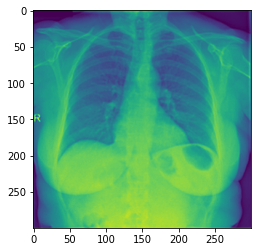

Batch[8].class: Normal
Batch[8].shape: (300, 300)


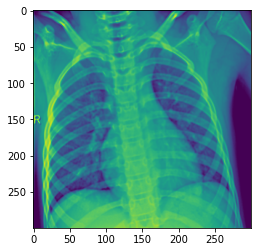

In [29]:
def plot_sample_images(loader):
    # Showing an image example of each class
    printed_class = [False, False]
    class_name = ['Covid', 'Normal']
    for idx, (batchx, batchy) in enumerate(loader):
        img_classes = np.squeeze(batchy.numpy()).astype(int)
        batch_size = 1 if not img_classes.shape else img_classes.shape[0]
        np_img_batch = np.squeeze(batchx.numpy())
        iterable = zip([np_img_batch], [img_classes]) if not img_classes.shape else zip(np_img_batch, img_classes)
        for bidx, (img, label) in enumerate(iterable):
            if printed_class[label] is False:
                print('Batch[{}].class: {}'.format(idx+bidx*batch_size, class_name[label]))
                print('Batch[{}].shape: {}'.format(idx+bidx*batch_size, img.shape))
                pltimg = np.squeeze(img)
                plt.figure()
                plt.imshow(pltimg)
                plt.show()
                printed_class[label] = True
                if (printed_class[0] is True) and (printed_class[1] is True): return

plot_sample_images(loader)

# Creating Conditional GAN model and Discriminator (according to paper)

*The generator network in this research consists of five transposed convolutional layers, four ReLU layers, four batch normalization layers, and Tanh Layer at the end of
the model, while the discriminator network consists of five convolutional layers, four leaky ReLU,
and three batch normalization layers. All the convolutional and transposed convolutional layers used
the same window size of 4x4 pixel with 64 filters for each layer.*

In [30]:
class Discriminator(nn.Module):
    def __init__(self, img_input_shape, num_classes, embedding_dim=50):
        super(Discriminator, self).__init__()
        # this is the normal image shape (i.e. h x w x c) - not the pytorch image input shape (c x w x h)
        self.input_shape = img_input_shape 
        self.embedding_path = nn.Sequential(*[
            nn.Embedding(num_embeddings=num_classes, embedding_dim=embedding_dim),
            nn.Linear(embedding_dim, img_input_shape[0]*img_input_shape[1]),
        ])

        self.conv_net = nn.Sequential(*[
            # first conv layer set (no batch)
            nn.Conv2d(img_input_shape[2]+1, 64, 4),
            nn.LeakyReLU(inplace=False),

            nn.Conv2d(64, 64, 4, stride=2),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(inplace=False),

            nn.Conv2d(64, 64, 4, stride=2),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(inplace=False),

            nn.Conv2d(64, 64, 4, stride=2),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(inplace=False),

            nn.Conv2d(64, 64, 4),
            nn.LeakyReLU(inplace=False),
            # output dimension will be (1, 64, 32, 32)
        ])

        self.softmax_layer = nn.Sequential(*[
            nn.Flatten(),
            nn.Dropout(inplace=False),
            nn.Linear(64*32*32, 1),
            nn.Sigmoid()
        ])

    def forward(self, image, label):
        # print('DEBUG: image tensor device: {}'.format(image.device))
        # print('DEBUG: label tensor device: {}'.format(label.device))
        li_out = self.embedding_path(label)
        li_out = li_out.view(-1, 1, self.input_shape[0], self.input_shape[1])
        # print('DEBUG: li_out shape: {}'.format(li_out.shape))
        conv_in = torch.cat((image, li_out), dim=1)
        # print('DEBUG: conv in shape: {}'.format(conv_in.shape))
        conv_out = self.conv_net(conv_in)
        # print('DEBUG: conv out shape: {}'.format(conv_out.shape))
        result = self.softmax_layer(conv_out)
        return result
        


class Generator(nn.Module):
    def __init__(self, input_width, num_classes, embedding_dim=50):
        super(Generator, self).__init__()
        latent_dimension = input_width
        self.embedding_path_output = 8
        self.latent_channels = input_width
        self.latent_dimension_output = self.latent_channels * (self.embedding_path_output**2)

        self.embedding_path = nn.Sequential(*[
            nn.Embedding(num_embeddings=num_classes, embedding_dim=embedding_dim),
            nn.Linear(embedding_dim, (self.embedding_path_output**2)),
        ]) 

        self.generator_input_path = nn.Sequential(*[
            nn.Linear(latent_dimension, self.latent_dimension_output),
            nn.ReLU(inplace=False),
        ])

        self.conv_net = nn.Sequential(*[
            # first transposed conv layer set
            nn.ConvTranspose2d(self.latent_channels+1, latent_dimension*8, 4, stride=2),
            nn.BatchNorm2d(latent_dimension*8),
            nn.ReLU(inplace=False),
            # 2nd conv layer set
            nn.ConvTranspose2d(latent_dimension*8, latent_dimension*4, 4, stride=2),
            nn.BatchNorm2d(latent_dimension*4),
            nn.ReLU(inplace=False),
            # 3rd conv layer set
            nn.ConvTranspose2d(latent_dimension*4, latent_dimension*2, 4, stride=2, padding=2),
            nn.BatchNorm2d(latent_dimension*2),
            nn.ReLU(inplace=False),
            # 4th conv layer set
            nn.ConvTranspose2d(latent_dimension*2, latent_dimension, 4, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(latent_dimension),
            nn.ReLU(inplace=False),

            # 5th conv layer set
            nn.ConvTranspose2d(latent_dimension, 1, 4, stride=2),
            nn.Tanh()
        ])


    def forward(self, z, label):
        # print('DEBUG: z tensor device: {}'.format(z.device))
        # print('DEBUG: label tensor device: {}'.format(label.device))
        li_out = self.embedding_path(label)
        gi_out = self.generator_input_path(z)
        # print('DEBUG: gi_out tensor shape: {}'.format(gi_out.shape))
        # print('DEBUG: li_out tensor shape: {}'.format(li_out.shape))
        gi_out = gi_out.view(-1, self.latent_channels, self.embedding_path_output, self.embedding_path_output)
        # print('DEBUG: gi_out tensor reshape: {}'.format(gi_out.shape))
        li_out = li_out.view(-1, 1, self.embedding_path_output, self.embedding_path_output)
        # print('DEBUG: li_out tensor reshape: {}'.format(li_out.shape))
        conv_in = torch.cat((gi_out, li_out), dim=1)
        # print('DEBUG: Convin shape: {}'.format(conv_in.shape))
        return self.conv_net(conv_in)

In [37]:
def initialize_optimizer(model_parameters, option_dict):
    if option_dict['name'] == 'Adam':
        return torch.optim.Adam(params=model_parameters, lr=option_dict['lr'], betas=(option_dict['beta1'], option_dict['beta2']))
    elif option_dict['name'] == 'SGD':
        return torch.optim.SGD(params=model_parameters, lr=option_dict['lr'], momentum=option_dict['momentum'])
    else: # default optimizer
        option_dict['name'] = 'SGD'
        return torch.optim.SGD(params=model_parameters, lr=option_dict['lr'], momentum=option_dict['momentum'])
    # can add more options later


class Lung_CGAN():
    default_optim_dict = {
        'lr':0.01,
        'beta1':0.5,
        'beta2':0.999,
        'momentum':0.9,
        'name':'SGD',
        # can add more parameters for the optmizers as needed later
    }
    tensorboard_dir = 'tensorboard_dir'
    checkpoint_file_prefix = 'lung_cgan__'

    def __init__(self, image_dimension, num_classes, noise_dimension=256, **kwargs):
        self.noise_dim = noise_dimension
        self.num_classes = num_classes
        self.image_dimension = image_dimension
        self.emb_dim    = kwargs.get('embedding_dim', 50)
        self.device     = kwargs.get('device', 'cpu') # device default is cpu 
        self.generator = Generator(noise_dimension, num_classes, embedding_dim=self.emb_dim).to(device)
        self.discriminator = Discriminator(image_dimension, num_classes, embedding_dim=self.emb_dim).to(device)
        self.gen_loss_history = []
        self.disc_loss_history = []
        self.gen_optim = None
        self.disc_optim = None
        self.tb_writer_fake = None
        self.tb_writer_losses = None
        self.tb_writer_real = None
        self.current_epoch = None

    def training_loop(self, data_loader, epochs=1000, **kwargs):
        # custom options for the training loop
        chkpt_after_train       = kwargs.get('chkpt_after_train', True)
        train_from_latest_chkpt = kwargs.get('train_from_latest_chkpt', True)
        checkpt_directory       = kwargs.get('chkpt_dir', '/content/chkpt_dir/')
        enable_tensorboard      = kwargs.get('enable_tensorboard', True)        # logs to tensorboard every epoch
        summary_modulo          = kwargs.get('summary_n_steps', 5)              # writes to tensorboard every 5 training steps (by default)
        adversarial_loss        = kwargs.get('adversarial_loss', torch.nn.MSELoss())
        log_modulo              = kwargs.get('log_n_steps', 10)                 # logs to std output every 10 training steps (by default)
        verbose                 = kwargs.get('verbose', True)
        clear_losses            = kwargs.get('clear_accumulated_losses', True)  # clears the acumulated losses by default
        optimizer_init          = kwargs.get('network_optimizer', 'SGD')        # type of optimizer
        optimizer_option_dict   = kwargs.get('optmizer_options_dict', None)
        
        # merge the optimizer option dictionaries and create a set of parameters
        optimizer_option_dict   = (Lung_CGAN.default_optim_dict if optimizer_option_dict is None  
                                   else {**Lung_CGAN.default_optim_dict, **optimizer_option_dict})
        optimizer_option_dict['name'] = optimizer_init

        # load checkpoint before training (finds the oldest training checkpoint)
        loaded_from_checkpoint = False
        loaded_checkpoint_dict = None
        if train_from_latest_chkpt:
            if verbose: print('Checking for existing model checkpoint to train from...')
            checkpoint_list = []
            if os.path.exists(checkpt_directory):
                for file in os.listdir(checkpt_directory):
                    if file.endswith(".chkpt"): checkpoint_list.append(os.path.join(checkpt_directory, file))
            
            # if there are checkpoints available
            if checkpoint_list:
                checkpoint_list.sort(key=lambda f: int(re.sub('\D', '', f)), reverse=True)
                file_base_name = os.path.splitext(os.path.basename(checkpoint_list[0]))[0]
                file_epoch = int(file_base_name.replace(checkpoint_file_prefix, ''))
                
                # checks if the current trained epoch is the same as the file its loading from (to prevent redundant loading)
                if ((self.current_epoch is not None) and (self.current_epoch < file_epoch)) or (self.current_epoch is None):
                    self.current_epoch = file_epoch
                    if verbose: print('Loading model from latest checkpoint: file path = "{}"'.format(checkpoint_list[0]))
                    loaded_checkpoint_dict = torch.load(checkpoint_list[0], map_location=self.device) # loads tensors onto gpu
                    self.generator.load_state_dict(loaded_checkpoint_dict['generator_model'])
                    self.discriminator.load_state_dict(loaded_checkpoint_dict['discriminator_model'])
                    
                    # get optimizer options and setup up optimizer from parameters
                    chkpt_optimizer_option_dict = loaded_checkpoint_dict['optimizer_options']
                    self.gen_optim = initialize_optimizer(self.generator.parameters(), chkpt_optimizer_option_dict)
                    self.disc_optim = initialize_optimizer(self.discriminator.parameters(), chkpt_optimizer_option_dict)

                    # load optimizer parameters
                    self.gen_optim.load_state_dict(loaded_checkpoint_dict['generator_optimizer'])
                    self.disc_optim.load_state_dict(loaded_checkpoint_dict['discriminator_optimizer'])
                    loaded_from_checkpoint = True
            elif verbose: print('Found no checkpoints.')

        tb_fixed_noise_vector = None
        tb_fixed_labels_vector = None
        tb_step_counter = 0
        tb_show_real_once_flag = True
        if enable_tensorboard:
            # clear tensorboard directory
            if os.path.exists(Lung_CGAN.tensorboard_dir) and os.path.isdir(Lung_CGAN.tensorboard_dir):
                # not quite working for me
                !rm -rf $Lung_CGAN.tensorboard_dir

            self.tb_writer_fake = SummaryWriter(os.path.join(Lung_CGAN.tensorboard_dir, 'Lung_CGAN/fake'))
            self.tb_writer_real = SummaryWriter(os.path.join(Lung_CGAN.tensorboard_dir, 'Lung_CGAN/real'))
            self.tb_writer_losses = SummaryWriter(os.path.join(Lung_CGAN.tensorboard_dir, 'Lung_CGAN/losses'))

        # load optimizers if not already loaded
        if self.gen_optim is None: 
            self.gen_optim  = initialize_optimizer(self.generator.parameters(), optimizer_option_dict)
        if self.disc_optim is None: 
            self.disc_optim = initialize_optimizer(self.discriminator.parameters(), optimizer_option_dict)

        self.generator.train()
        self.discriminator.train()

        # clear accumulated losses
        if clear_losses: self.gen_loss_history.clear(); self.disc_loss_history.clear();

        # Training Loop 
        batch_size = None
        if verbose: print('Starting training...')
        data_loader_size = len(data_loader)
        for epoc in tqdm(range(epochs), desc='Epochs', position=0, leave=False):
            for step, (image_batch, label_batch) in enumerate(tqdm(data_loader, desc='Training Step', position=0, leave=False)):
                # print('DEBUG: batch idx: {}'.format(step))
                if batch_size is None: batch_size = image_batch.shape[0]

                # adversarial ground truth (for discriminator)
                valid = Variable(torch.ones((batch_size, 1), device=self.device)) # for the discrim training
                fake = Variable(torch.zeros((batch_size, 1), device=self.device)) # for the gener training

                real_img_batch = Variable(image_batch.to(device))
                real_lbl_batch = Variable(label_batch.to(device))

                # -----------------
                #  Train Generator
                # -----------------
                self.gen_optim.zero_grad()
                # random sample of noise as generator input
                z = Variable(torch.normal(0, 1, (batch_size, self.noise_dim), device=self.device))
                gen_labels = Variable(torch.randint(0, self.num_classes, (batch_size,), device=self.device))
                # generate a batch of images
                gen_imgs = self.generator(z, gen_labels)
                # measure generator ability to fool discriminator
                validity = self.discriminator(gen_imgs, gen_labels)
                gen_loss = adversarial_loss(validity, valid)
                if (step % log_modulo == 0): self.gen_loss_history.append(gen_loss.detach())
                if enable_tensorboard: self.tb_writer_losses.add_scalar('Loss/generator', gen_loss.detach(), 
                                                                        epoc*data_loader_size + step)
                gen_loss.backward()
                self.gen_optim.step()
                
                # ---------------------
                #  Train Discriminator
                # ---------------------
                self.disc_optim.zero_grad()
                # loss for real images
                validity_real = self.discriminator(real_img_batch, real_lbl_batch)
                d_real_loss = adversarial_loss(validity_real, valid)
                # loss for fake images
                validity_fake = self.discriminator(gen_imgs.detach(), gen_labels)
                d_fake_loss = adversarial_loss(validity_fake, fake)

                # total loss
                d_loss_total = (d_real_loss + d_fake_loss)/2
                if (step % log_modulo == 0): self.disc_loss_history.append(d_loss_total.detach())
                if enable_tensorboard: self.tb_writer_losses.add_scalar('Loss/discriminator', d_loss_total.detach(),
                                                                        epoc*data_loader_size + step)
                d_loss_total.backward()
                self.disc_optim.step()

                if verbose and (step % log_modulo == 0): 
                    print("Epoch: [{}], Batch: [{}], Generator Loss: [{}], Discriminator Loss: [{}]"
                    .format(epoc, step, self.gen_loss_history[-1], self.disc_loss_history[-1]))

                if enable_tensorboard and (step % summary_modulo == 0):
                    assert (self.tb_writer_fake is not None)
                    assert (self.tb_writer_real is not None)

                    # generate the fixed tensorboard input vectors for seeing progress in generating images
                    if tb_fixed_noise_vector is None: 
                        tb_fixed_noise_vector = torch.randn((batch_size, self.noise_dim), device=self.device)
                    if tb_fixed_labels_vector is None:
                        temp1 = torch.ones(batch_size//2, dtype=torch.int, device=self.device)
                        temp2 = torch.zeros(batch_size - batch_size//2, dtype=torch.int, device=self.device)
                        tb_fixed_labels_vector = torch.cat((temp1, temp2))
                    
                    with torch.no_grad():
                        assert (tb_fixed_noise_vector is not None)
                        assert (tb_fixed_labels_vector is not None)
                        self.generator.eval()
                        fake_imgs = self.generator(tb_fixed_noise_vector, tb_fixed_labels_vector).reshape(-1, *self.image_dimension[::-1]) 
                        igrid_fake = torchvision.utils.make_grid(fake_imgs, normalize=True)
                        self.tb_writer_fake.add_image('Lung fake image(s)', igrid_fake, global_step=tb_step_counter)

                        if tb_show_real_once_flag: # show the real images once as a preview
                            real_imgs = image_batch.reshape(-1, *self.image_dimension[::-1]) # need to get dims s.t. shape(b, c, h, w)
                            igrid_real = torchvision.utils.make_grid(real_imgs, normalize=True)
                            self.tb_writer_real.add_image('Lung real image(s)', igrid_real, global_step=0)
                            tb_show_real_once_flag = False;

                        tb_step_counter += 1
                        self.generator.train()

        # after training 
        self.tb_writer_fake.close()
        self.tb_writer_real.close()
        self.generator.eval()
        if verbose: print('Finished Training.')
        self.current_epoch = self.current_epoch + epochs if self.current_epoch is not None else epochs

        # save checkpoint if applicable
        if chkpt_after_train:
            torch_chkpt_file_path = os.path.join(checkpt_directory, Lung_CGAN.checkpoint_file_prefix + str(self.current_epoch))
            if verbose: print('Saving model checkpoint... file path = "{}"'.format(torch_chkpt_file_path))
            
            # saving model parameters
            torch_chkpt_dict = {}
            torch_chkpt_dict['generator_model'] = self.generator.state_dict()
            torch_chkpt_dict['discriminator_model'] = self.discriminator.state_dict()
            torch_chkpt_dict['generator_optimizer'] = self.gen_optim.state_dict()
            torch_chkpt_dict['discriminator_optimizer'] = self.disc_optim.state_dict()

            # saving optimizer options (for reinitialization later)
            if loaded_from_checkpoint:
                assert (loaded_checkpoint_dict is not None)
                torch_chkpt_dict['optimizer_options'] = loaded_checkpoint_dict['optimizer_options']
            else:
                torch_chkpt_dict['optimizer_options'] = optimizer_option_dict
            
            torch.save(torch_chkpt_dict, torch_chkpt_file_path)
        if verbose: print('Done!')

    # def generate_random_image(label, num_images=1):


# Training model

In [45]:
# call this to clear the tensorboard data
!rm -rf $Lung_CGAN.tensorboard_dir

In [46]:
%tensorboard --logdir $Lung_CGAN.tensorboard_dir

<IPython.core.display.Javascript object>

In [47]:
try: del gan
except: pass
gan = Lung_CGAN((300, 300, 1), 2, noise_dimension=128, device=device)

In [48]:
optimizer_options_dict = {'lr':0.0002, 'name':'Adam', 'beta1':0.5, 'beta2':0.999}
adversarial_loss = torch.nn.BCELoss()
gan.training_loop(loader, epochs=5, summary_n_steps=1, verbose=False, optimizer_options_dict=optimizer_options_dict, adversarial_loss=adversarial_loss)

FileNotFoundError: ignored

# Debugging cells

In [48]:
# ## DEBUGGING TO GET THE OUTPUT SHAPE CORRECT
# gen = Generator(input_width=256, num_classes=2)
# gen.train()
# latent_vector = torch.rand(256)
# result = gen(latent_vector, torch.from_numpy(np.array([1])))
# print('DEBUG: generator output shape: {}'.format(result.shape))

# ## DEBUGGING DISCRIMINATOR TO GET OUTPUT SHAPE
# disc = Discriminator((300, 300, 1), 2)
# disc.train()

# result = disc(result, torch.from_numpy(np.array([1])))
# print('DEBUG: discriminator output shape: {}'.format(result.shape))
# print('Generator model summary:\n{}'.format(gen))
# print('Discriminator model summary:\n{}'.format(disc))

In [269]:
## DEBUGGING TO GET THE OUTPUT SHAPE CORRECT
# testin = torch.rand((1, 129, 8, 8))
# first_layer = nn.Sequential(*[
#     nn.ConvTranspose2d(129, 128*8, 4, stride=2),
#     nn.BatchNorm2d(128*8),
#     nn.LeakyReLU(inplace=True),
# ])
# out = first_layer(testin)
# print('DEBUG: out.shape: {}'.format(out.shape))

# second_layer = nn.Sequential(*[
#     nn.ConvTranspose2d(128*8, 128*4, 4, stride=2),
#     nn.BatchNorm2d(128*4),
#     nn.LeakyReLU(inplace=True),
# ])

# out = second_layer(out)
# print('DEBUG: out.shape: {}'.format(out.shape))


# third_layer = nn.Sequential(*[
#     nn.ConvTranspose2d(128*4, 128*2, 4, stride=2, padding=2),
#     nn.BatchNorm2d(128*2),
#     nn.LeakyReLU(inplace=True),
# ])

# out = third_layer(out)
# print('DEBUG: out.shape: {}'.format(out.shape))

# fourth_layer = nn.Sequential(*[
#     nn.ConvTranspose2d(128*2, 128, 4, stride=2, padding=1, output_padding=1),
#     nn.BatchNorm2d(128),
#     nn.LeakyReLU(inplace=True),
# ])

# out = fourth_layer(out)
# print('DEBUG: out.shape: {}'.format(out.shape))

# final_layer = nn.Sequential(*[
#     nn.ConvTranspose2d(128, 1, 4, stride=2),
#     nn.Tanh()
# ])

# out = final_layer(out)
# print('DEBUG: out.shape: {}'.format(out.shape))